In [1]:
import pycircos
import collections
import matplotlib.pyplot as plt
Garc = pycircos.Garc
Gcircle = pycircos.Gcircle

In [2]:
import os
import pandas as pd
import numpy as np
import matplotlib as mpl
import seaborn as sns

In [3]:
from PIL import Image

def crop_image(input_path, output_path, padding=750):
    img = Image.open(input_path)
    width, height = img.size

    # Define the points for cropping, adjust the values as needed
    # Note: The order of the box tuple is (left, upper, right, lower)
    box = (padding, padding, width - padding, height - padding)
    
    cropped_img = img.crop(box)
    cropped_img.save(output_path)


In [4]:
sample_names = \
['A_RR_GBM809',
 'A_R_GBM607',
 'B_P_GBM593',
 'B_R_GBM898',
 'C_RR_GBM937',
 'C_R_GBM781',
 'D_P_GBM620',
 'D_R_GBM691',
 'E_P_GBM454',
 'E_R_GBM833',
 'F_P_GBM460',
 'F_R_GBM492',
 'G_P_GBM401',
 'G_RR_GBM551',
 'G_R_GBM498',
 'H_P_GBM529',
 'H_R_GBM832',
 'I_P_BT2013110',
 'I_R_GBM745',
 'J_P_GBM703',
 'J_R_SMTB781',
 'X_P_GBM440',
 'X_P_GBM577',
 'X_P_GBM618',
 'X_P_GBM672',
 'X_P_SMTB123',
 'X_R_GBM945',
 'X_R_SMTB135',
 'X_R_SMTB241',
 'X_R_SMTB302',
 'X_R_SMTB814']

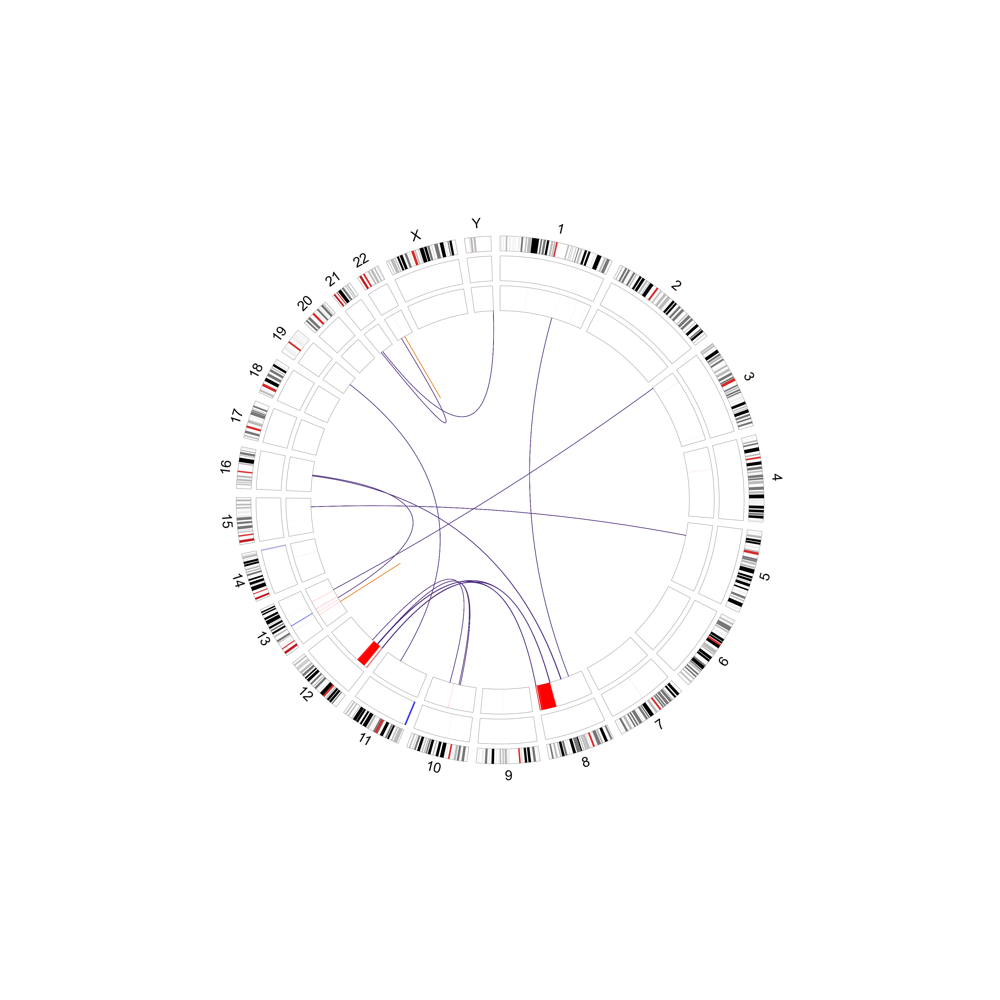

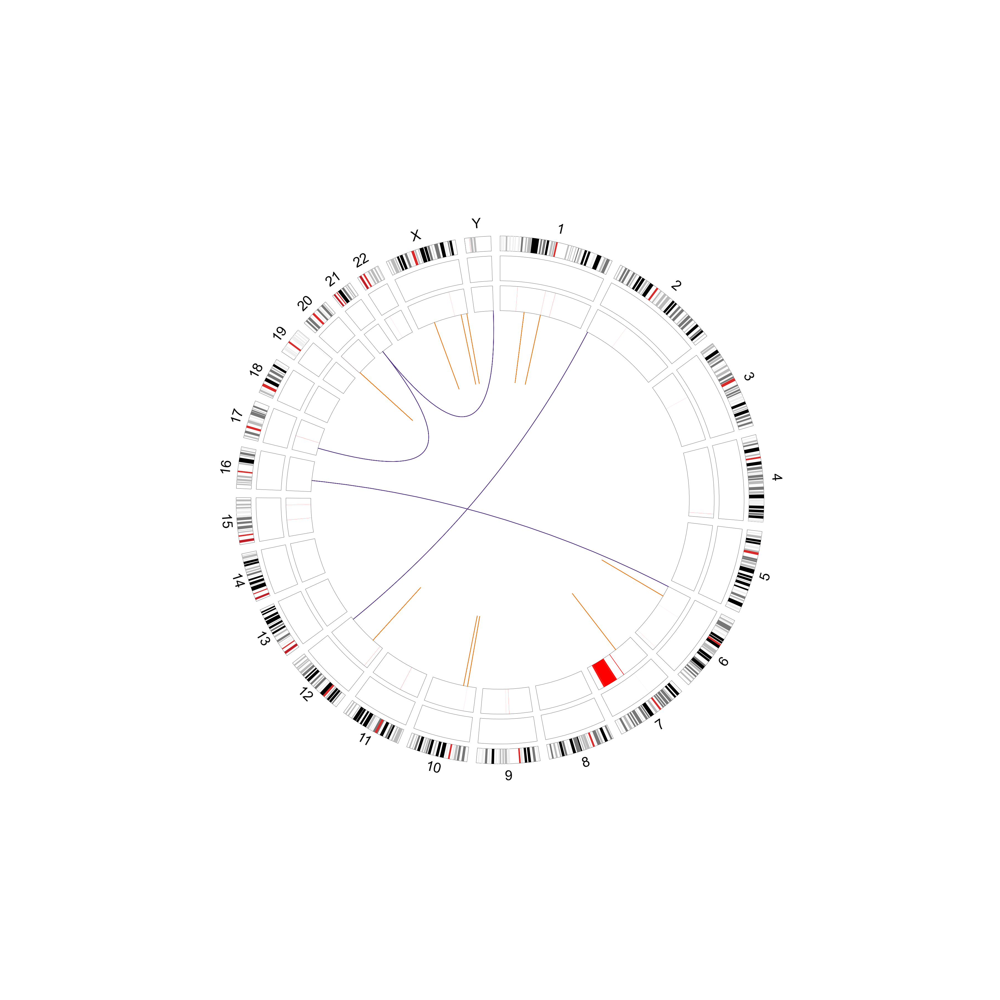

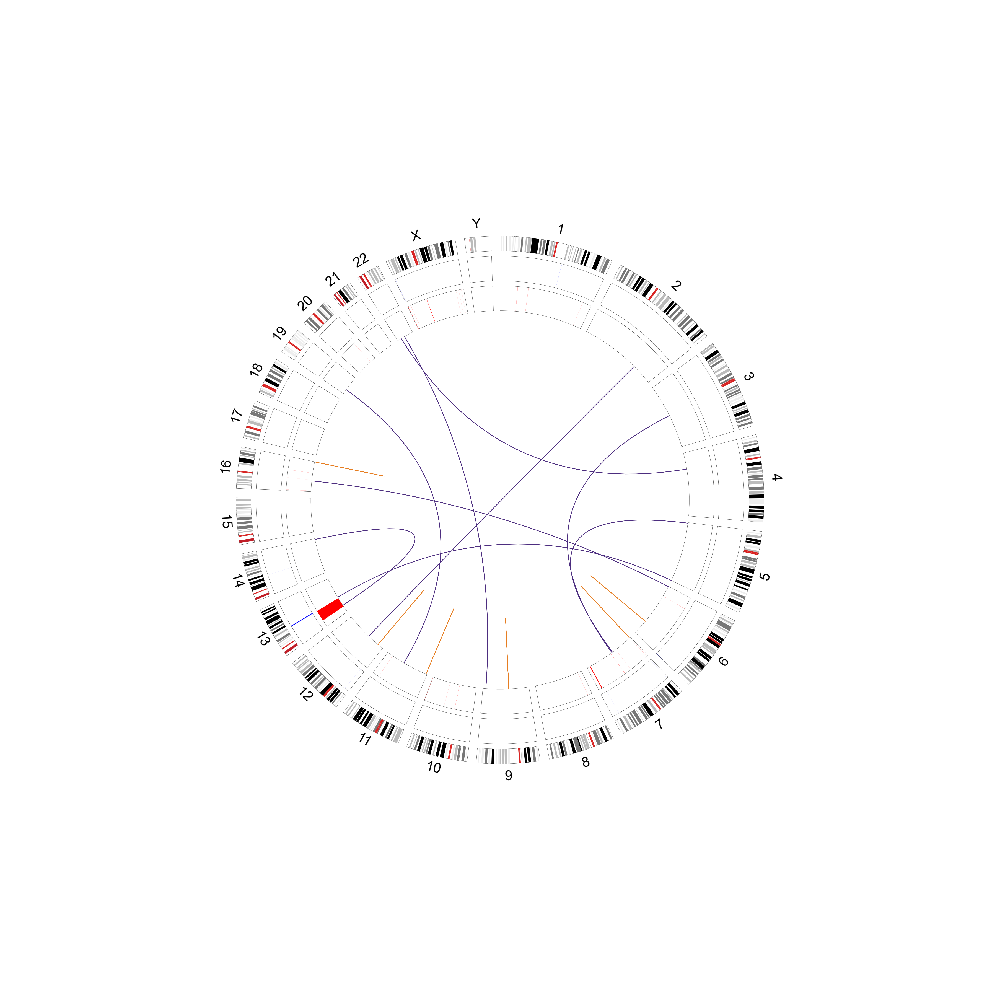

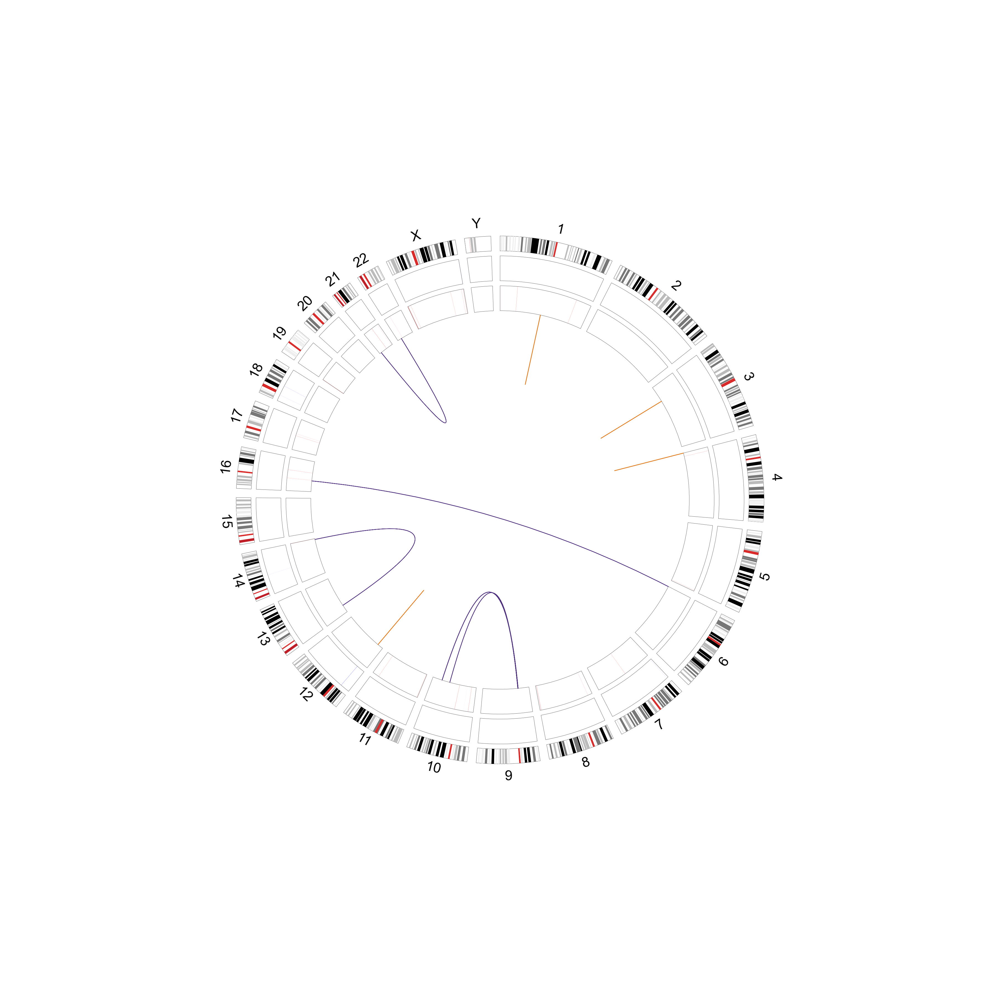

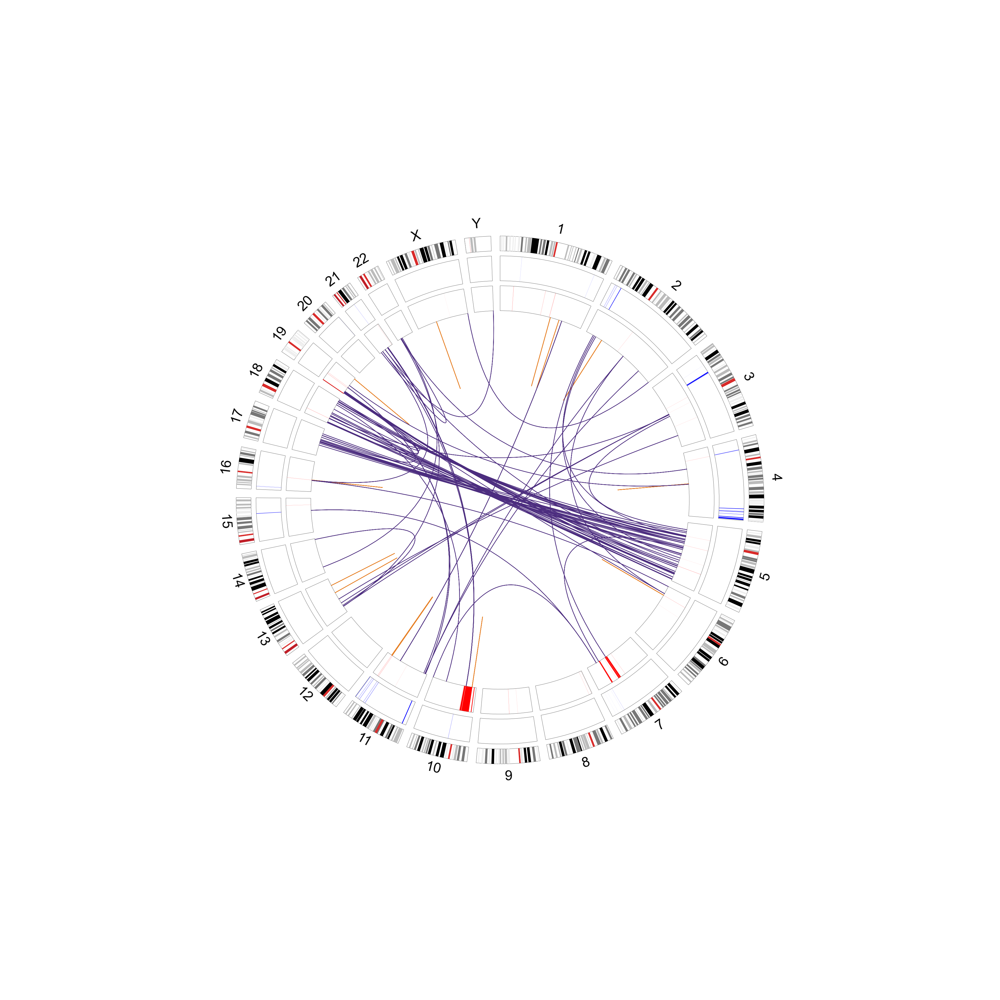

...

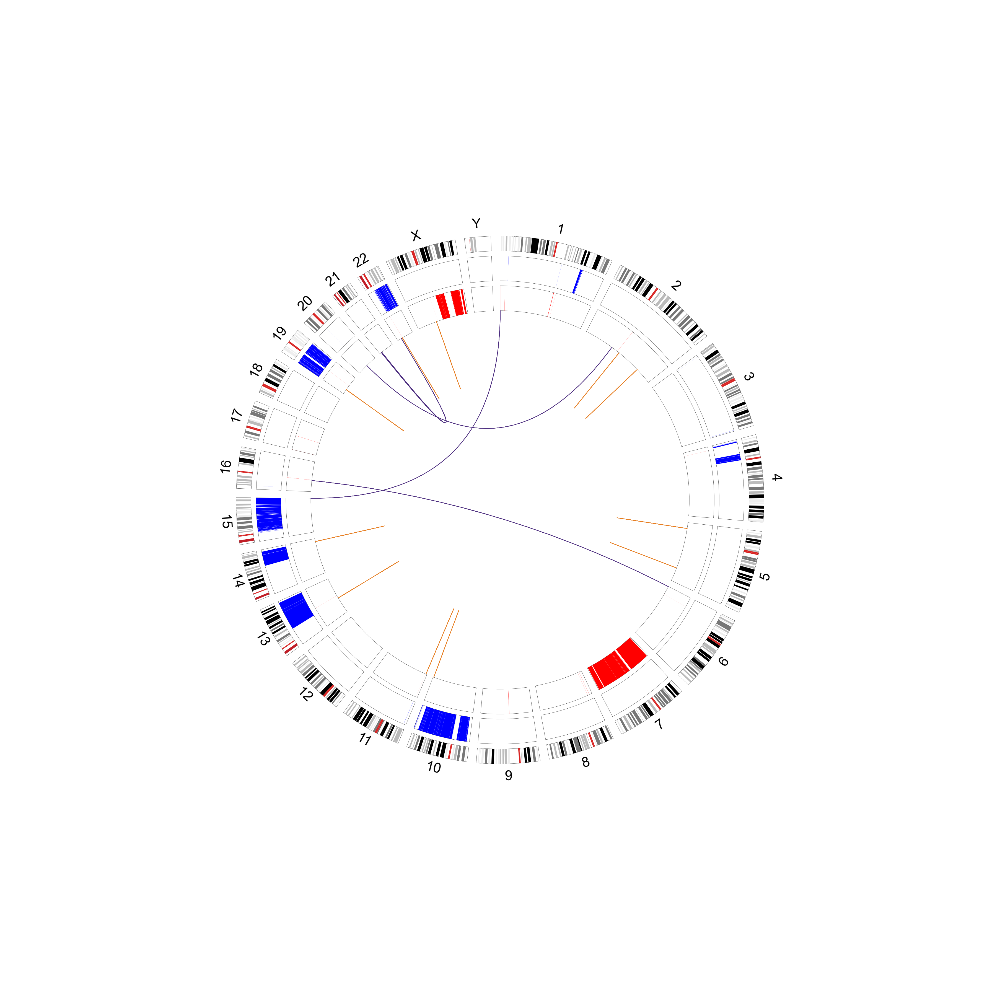

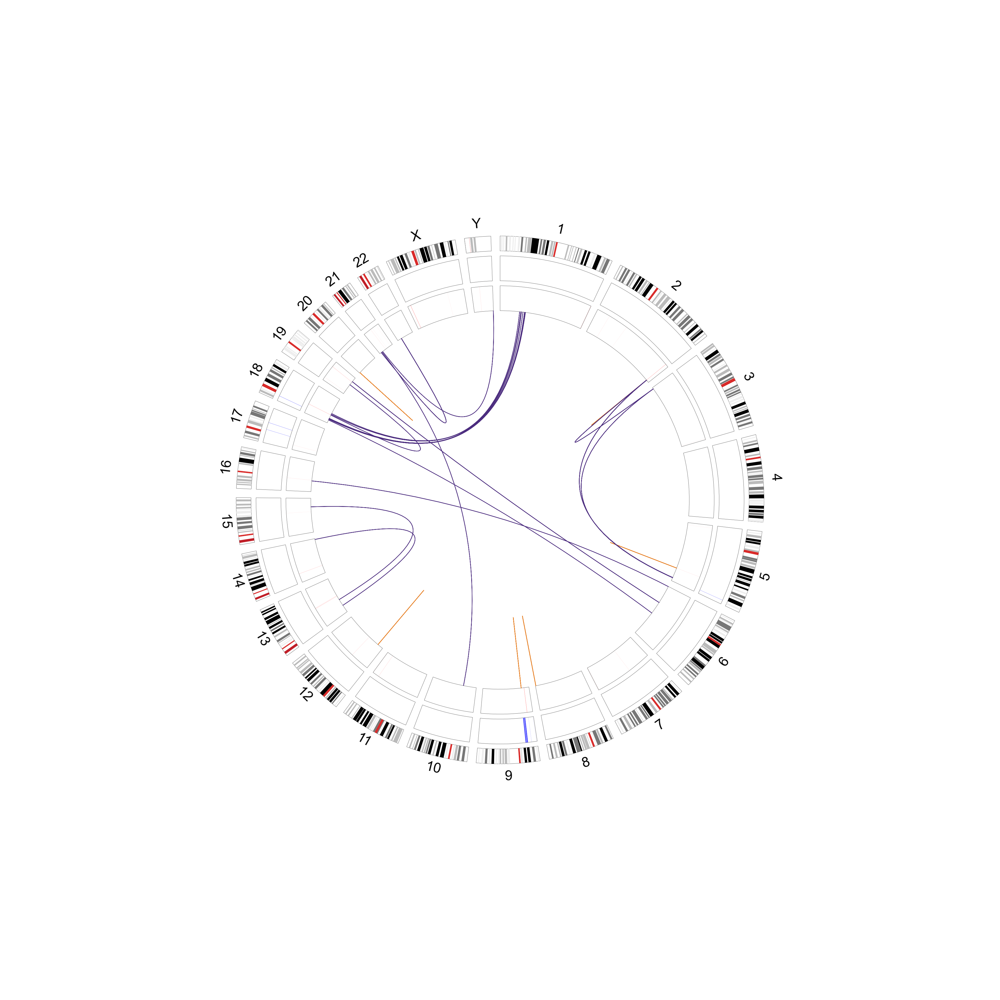

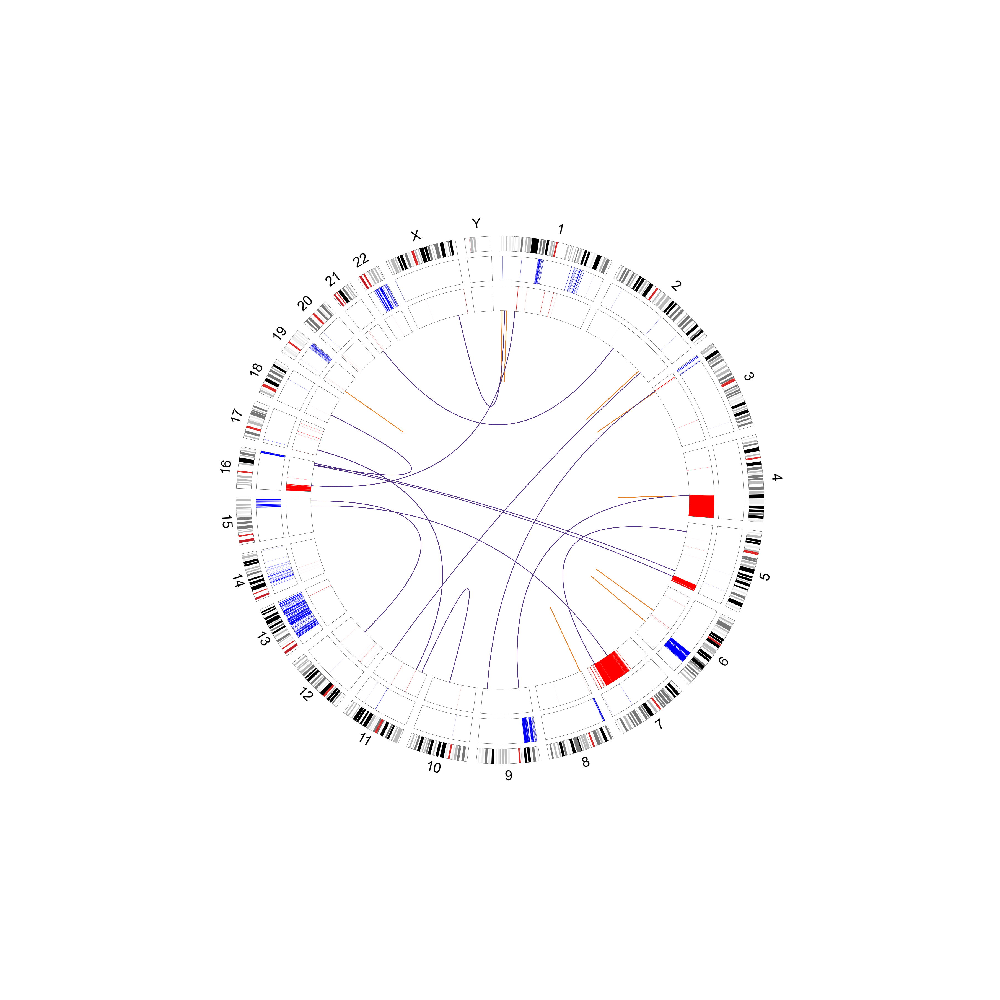

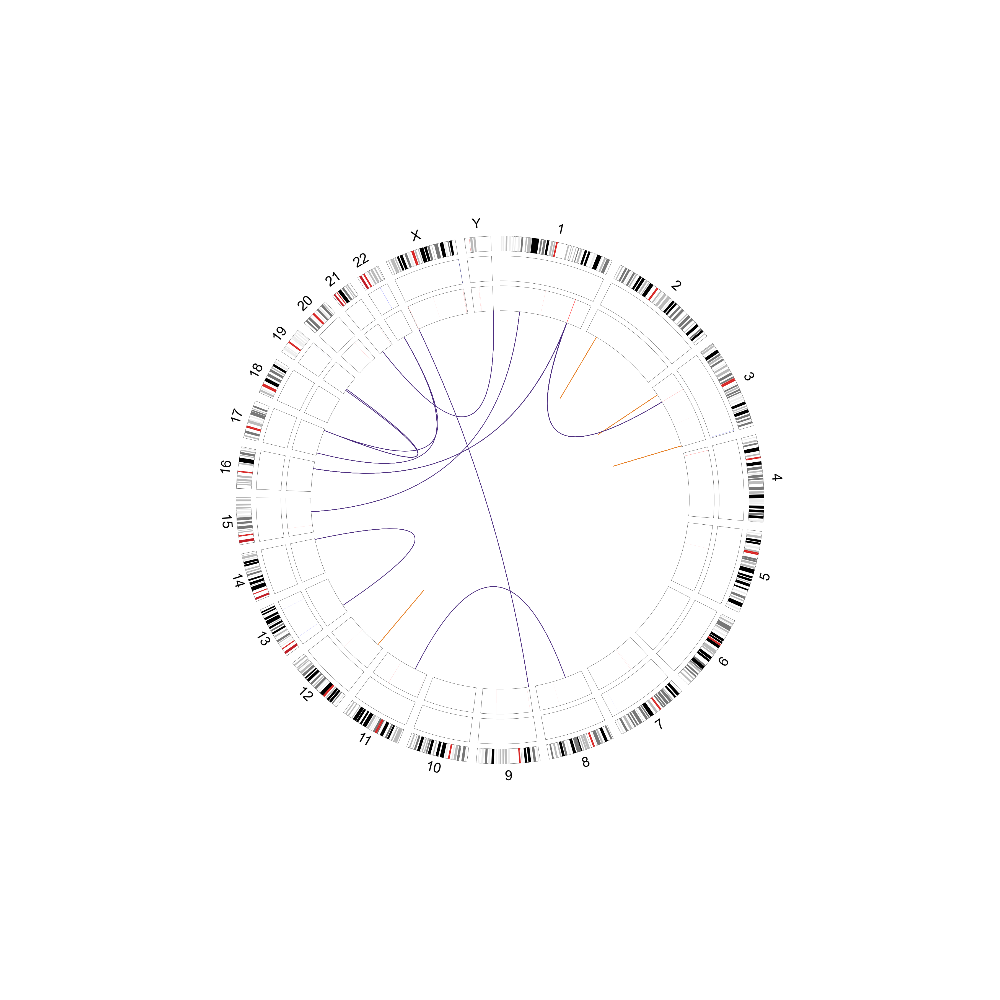

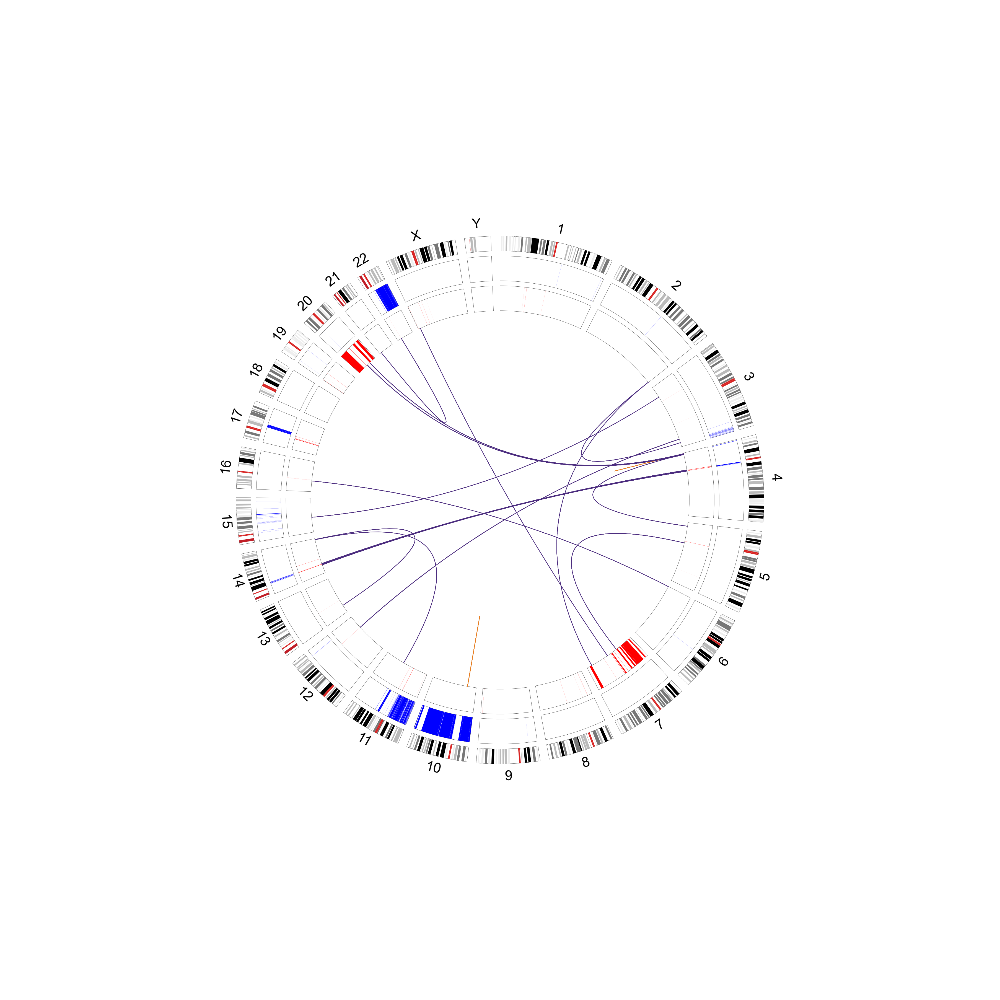

In [5]:
for temp_sample_name in sample_names:

    # set chromosomes
    circle = Gcircle(figsize=(50,50))
    with open("/Users/ryanyutian/Desktop/202306_CIRCOS/hg38_chromosome_general.csv") as f:
        f.readline()
        for line in f:
            line   = line.rstrip().split(",")
            name   = line[0][3:]
            length = int(line[-1]) 
            arc    = Garc(arc_id=name, size=length, interspace=2, facecolor="#FFFFFF00", \
                          raxis_range=(500,530), labelposition=40, label_visible=True, labelsize=50)
            circle.add_garc(arc)
    
    circle.set_garcs()
    
    
    # cytoband
    color_dict   = {"gneg":"#FFFFFF00", "gpos25":"#EEEEEE", "gpos50":"#BBBBBB", "gpos75":"#777777", "gpos100":"#000000", "gvar":"#FFFFFF00", "stalk":"#C01E27", 
                   "acen":"#D82322"}

    arcdata_dict = collections.defaultdict(dict)
    with open("/Users/ryanyutian/Desktop/202306_CIRCOS/hg38_chromosome_cytoband.csv") as f:
        f.readline()
        for line in f:
            line  = line.rstrip().split(",")
            name  = line[0][3:]   
            start = int(line[1])-1 
            width = int(line[2])-(int(line[1])-1) 
            if name not in arcdata_dict:
                arcdata_dict[name]["positions"] = []
                arcdata_dict[name]["widths"]    = [] 
                arcdata_dict[name]["colors"]    = [] 
            arcdata_dict[name]["positions"].append(start) 
            arcdata_dict[name]["widths"].append(width)
            arcdata_dict[name]["colors"].append(color_dict[line[-1]])

    for key in arcdata_dict:
        circle.barplot(key, data=[1]*len(arcdata_dict[key]["positions"]), positions=arcdata_dict[key]["positions"], 
                       width=arcdata_dict[key]["widths"], raxis_range=[500,530], facecolor=arcdata_dict[key]["colors"])    
    
    
    # deletion heatmap
    values_all   = [] 
    arcdata_dict = collections.defaultdict(dict)
    with open("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/individual_data/DEL/nonzero/" + \
              temp_sample_name + "_large_DEL_heatmap_nonzero.csv") as f:
        f.readline()
        for line in f:
            line  = line.rstrip().split(",")
            name  = line[0][3:]
            start = int(line[1])-1
            end   = int(line[2]) 
            width = end-start
            if name not in arcdata_dict:
                arcdata_dict[name]["positions"] = []
                arcdata_dict[name]["widths"]    = [] 
                arcdata_dict[name]["values"]    = [] 
            arcdata_dict[name]["positions"].append(start) 
            arcdata_dict[name]["widths"].append(width)
            arcdata_dict[name]["values"].append(float(line[-1]))
            values_all.append(float(line[-1]))

    vmin, vmax = 0, 1

    for key in arcdata_dict:
        circle.heatmap(key, data=arcdata_dict[key]["values"], positions=arcdata_dict[key]["positions"], 
                       width=arcdata_dict[key]["widths"], raxis_range=[440,490], vmin=vmin, vmax=vmax, 
                       cmap=sns.color_palette("light:b", as_cmap=True), spine=True)

    
    # duplication heatmap
    values_all   = [] 
    arcdata_dict = collections.defaultdict(dict)
    with open("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/individual_data/DUP/nonzero/" + \
              temp_sample_name + "_large_DUP_heatmap_nonzero.csv") as f:
        f.readline()
        for line in f:
            line  = line.rstrip().split(",")
            name  = line[0][3:]    
            start = int(line[1])-1
            end   = int(line[2]) 
            width = end-start 
            if name not in arcdata_dict:
                arcdata_dict[name]["positions"] = []
                arcdata_dict[name]["widths"]    = [] 
                arcdata_dict[name]["values"]    = [] 
            arcdata_dict[name]["positions"].append(start) 
            arcdata_dict[name]["widths"].append(width)
            arcdata_dict[name]["values"].append(float(line[-1]))
            values_all.append(float(line[-1]))

    vmin, vmax = 0, 1
    for key in arcdata_dict:
        circle.heatmap(key, data=arcdata_dict[key]["values"], positions=arcdata_dict[key]["positions"], 
                       width=arcdata_dict[key]["widths"], raxis_range=[380,430], vmin=vmin, vmax=vmax, 
                       cmap=sns.color_palette("light:r", as_cmap=True), spine=True)
        
    #linkplot - inversion
    values_all   = [] 
    arcdata_dict = collections.defaultdict(dict)

    with open("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/individual_data/INV/" + \
             temp_sample_name + "_INV.csv") as f:
        f.readline()
        for line in f:
            line  = line.rstrip().split(",")
            name1  = line[0][3:]
            start1 = int(line[1])-1
            end1   = int(line[2])
            name2  = line[3][3:]
            start2 = int(line[4])-1
            end2   = int(line[5])
            source = (name1, start1, end1, 380)
            destination = (name2, start2, end2, 380)
            circle.chord_plot(source, destination, edgecolor="#E67E22", linewidth=2)

            
    #linkplot - Translocation
    values_all   = [] 
    arcdata_dict = collections.defaultdict(dict)

    with open("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/individual_data/BND/" + \
             temp_sample_name + "_BND.csv") as f:
        f.readline()
        for line in f:
            line  = line.rstrip().split(",")
            name1  = line[0][3:]
            start1 = int(line[1])-1
            end1   = int(line[2])
            name2  = line[3][3:]
            start2 = int(line[4])-1
            end2   = int(line[5])
            source = (name1, start1, end1, 380)
            destination = (name2, start2, end2, 380)
            circle.chord_plot(source, destination, edgecolor="#4C2D7F", linewidth=2)
    

    circle.figure.savefig("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/plot/individual_sample/" + \
                          temp_sample_name + "_CIRCOS.png")
    
    crop_image(("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/plot/individual_sample/" + \
                temp_sample_name + "_CIRCOS.png"), \
              ("/Users/ryanyutian/Desktop/Manuscript/CIRCOS/plot/individual_sample/cropped/" + \
                temp_sample_name + "_CIRCOS.png"))